In [1]:
import os
import numpy as np
import pandas as pd
import cv2

import tensorflow as tf
tf.config.list_physical_devices('GPU')

import matplotlib.pyplot as plt
import glob


from keras.models import Model, Sequential
from keras.layers import Dense, Flatten, Conv2D, MaxPooling2D
# from keras.layers.normalization import BatchNormalization
import os
import seaborn as sns


In [2]:
from tqdm import tqdm

### Data loading

In [3]:
import splitfolders
folder_path = '/Users/kimmonica/Documents/alexia/speech seg/dataset_2'
splitfolders.ratio(folder_path, output = folder_path, seed =77, ratio=(0.7, 0.2, 0.1))

Copying files: 0 files [00:00, ? files/s]

Copying files: 1014 files [00:00, 1983.63 files/s]


In [4]:
from sklearn.preprocessing import label_binarize
categories = ['4', '5','6','7','18']

In [5]:
folder_path = '/Users/kimmonica/Documents/alexia/speech seg/dataset_2/'
# SIZE = 128  #Resize images

#Capture training data and labels into respective lists
train_images = []
train_labels = [] 

for directory_path in tqdm (glob.glob(folder_path+'train/*')):
    label = directory_path.split("/")[-1]
    # print(label)
    for img_path in glob.glob(os.path.join(directory_path, "*.png")):
        # print(img_path)
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)       
        # img = cv2.resize(img, (SIZE, SIZE))
        if img.shape != (369, 251, 3):
            pass
        else:
            img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
            train_images.append(img)
            train_labels.append(label)

#Convert lists to arrays        
train_images = np.array(train_images)
train_labels = np.array(train_labels)
print(len(train_images))

100%|██████████| 5/5 [00:01<00:00,  2.98it/s]

704


In [6]:
folder_path = '/Users/kimmonica/Documents/alexia/speech seg/dataset_2/'
# SIZE = 128  #Resize images

#Capture training data and labels into respective lists
test_images = []
test_labels = [] 

for directory_path in tqdm (glob.glob(folder_path+'val/*')):
    label = directory_path.split("/")[-1]
    # print(label)
    for img_path in glob.glob(os.path.join(directory_path, "*.png")):
        # print(img_path)
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)       
        # img = cv2.resize(img, (SIZE, SIZE))
        if img.shape != (369, 251, 3):
            pass
        else:
            img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
            test_images.append(img)
            test_labels.append(label)

#Convert lists to arrays        
test_images = np.array(test_images)
test_labels = np.array(test_labels)
print(len(test_images))

100%|██████████| 5/5 [00:00<00:00, 10.54it/s]

201


### model work

In [7]:
#Encode labels from text to integers.
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
le.fit(test_labels)
test_labels_encoded = le.transform(test_labels)
le.fit(train_labels)
train_labels_encoded = le.transform(train_labels)

#Split data into test and train datasets (already split but assigning to meaningful convention)
x_train, y_train, x_test, y_test = train_images, train_labels_encoded, test_images, test_labels_encoded

# Normalize pixel values to between 0 and 1
x_train, x_test = x_train / 255.0, x_test / 255.0

#딥러닝으로 들어갈때는 원핫으로 들어가야함

from tensorflow.keras.utils import to_categorical
y_train_one_hot = to_categorical(y_train)
y_test_one_hot = to_categorical(y_test)

In [8]:
from keras.applications.vgg16 import VGG16

#Load model wothout classifier/fully connected layers
VGG_model = VGG16(weights='imagenet', include_top=False, input_shape=(369, 251, 3))

#Make loaded layers as non-trainable. This is important as we want to work with pre-trained weights
for layer in VGG_model.layers:
	layer.trainable = False
    
VGG_model.summary()  #Trainable parameters will be 0

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 369, 251, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 369, 251, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 369, 251, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 184, 125, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 184, 125, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 184, 125, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 92, 62, 128)       0     

In [9]:
print(x_train.shape)

(704, 369, 251, 3)


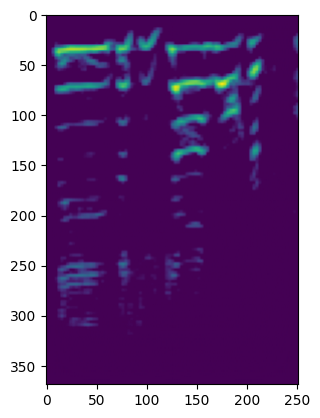

In [10]:
plt.imshow(x_train[0])

In [11]:
x_train[1].shape

(369, 251, 3)

In [12]:
#Now, let us use features from convolutional network for RF
feature_extractor=VGG_model.predict(x_train)

features = feature_extractor.reshape(feature_extractor.shape[0], -1)
X_train = features #This is our X input to RF

#RANDOM FOREST
from sklearn.ensemble import RandomForestClassifier
RF_model = RandomForestClassifier(n_estimators = 50, random_state = 42)

# Train the model on training data
RF_model.fit(X_train, y_train) #For sklearn no one hot encoding

#Send test data through same feature extractor process
X_test_feature = VGG_model.predict(x_test)
X_test_features = X_test_feature.reshape(X_test_feature.shape[0], -1)

#Now predict using the trained RF model. 
prediction_RF = RF_model.predict(X_test_features)
# print(prediction_RF)
#Inverse le transform to get original label back. 
prediction_RF = le.inverse_transform(prediction_RF)
# print(prediction_RF)

#Print overall accuracy
from sklearn import metrics
print ("Accuracy = ", metrics.accuracy_score(test_labels, prediction_RF))

2023-06-25 13:28:47.513289: W tensorflow/tsl/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


7/7 [==============================] - 2s 252ms/step
Accuracy =  0.9154228855721394


              precision    recall  f1-score   support

          18       0.91      0.97      0.93        89
           4       0.92      0.96      0.94       100
           5       1.00      0.33      0.50         6
           7       0.00      0.00      0.00         6

    accuracy                           0.92       201
   macro avg       0.71      0.56      0.59       201
weighted avg       0.89      0.92      0.90       201



/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_

<Axes: >

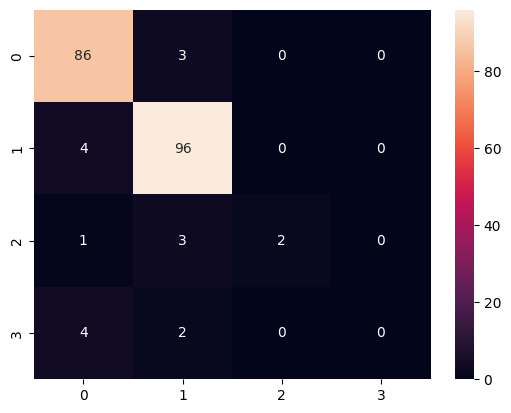

In [13]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
report = classification_report(test_labels, prediction_RF)
cm = confusion_matrix(test_labels, prediction_RF)
#print(cm)
print(report)
sns.heatmap(cm, annot=True)

              precision    recall  f1-score   support

       ADULT       1.00      0.93      0.96       116
       CHILD       0.96      1.00      0.98       210

    accuracy                           0.98       326
   macro avg       0.98      0.97      0.97       326
weighted avg       0.98      0.98      0.98       326



<Axes: >

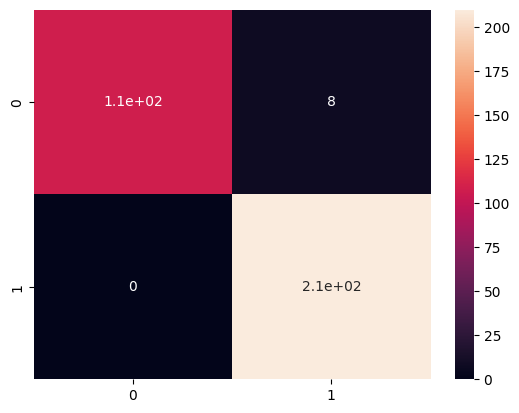

In [15]:
from sklearn.metrics import confusion_matrix
report = classification_report(test_labels, prediction_RF)
cm = confusion_matrix(test_labels, prediction_RF)
#print(cm)
print(report)
sns.heatmap(cm, annot=True)

1/1 [==============================] - 0s 59ms/step
The prediction for this image is:  ['ADULT']
The actual label for this image is:  ADULT


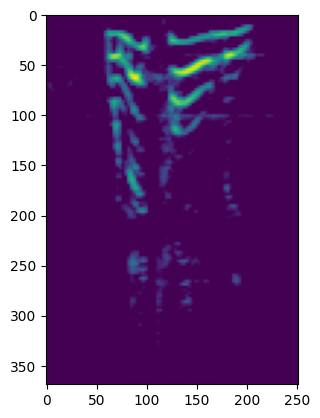

In [16]:
#Check results on a few select images
n=np.random.randint(0, x_test.shape[0])
img = x_test[n]
plt.imshow(img)
input_img = np.expand_dims(img, axis=0) #Expand dims so the input is (num images, x, y, c)
input_img_feature=VGG_model.predict(input_img)
input_img_features=input_img_feature.reshape(input_img_feature.shape[0], -1)
prediction_RF = RF_model.predict(input_img_features)[0] 
prediction_RF = le.inverse_transform([prediction_RF])  #Reverse the label encoder to original name
print("The prediction for this image is: ", prediction_RF)
print("The actual label for this image is: ", test_labels[n])

In [17]:
import joblib
joblib.dump(RF_model, '230620_RF_model_98.pkl')


['230620_RF_model_98.pkl']

### Model Evaluation

In [18]:
#evaluation
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import precision_score, recall_score, accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import roc_auc_score
from sklearn.metrics import classification_report

In [ ]:
y_score = RF_model.fit(X_train, y_train).predict_proba(X_test_features)
y_score

In [20]:
y = label_binarize(test_labels_encoded, classes=[0, 1])
y[0]

array([0])

In [21]:
n_classes = 2
# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_one_hot[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

In [22]:
from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score
from itertools import cycle

/var/folders/8q/qvkg_x054xg6wpd18ns2jgp40000gn/T/ipykernel_37259/3321945849.py:7: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


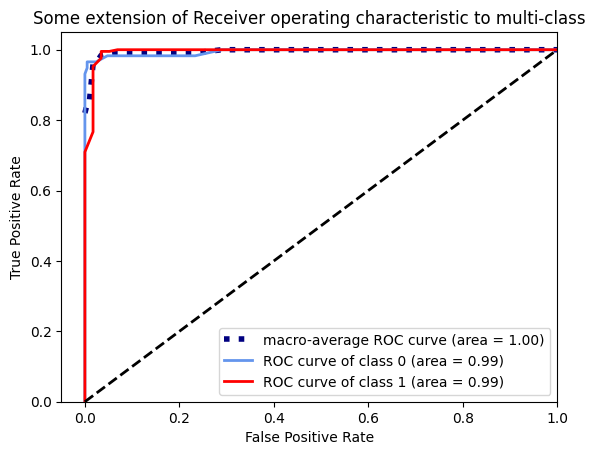

In [23]:
#First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure()
lw = 2
# plt.plot(fpr["micro"], tpr["micro"],
#          label='micro-average ROC curve (area = {0:0.2f})'
#                ''.format(roc_auc["micro"]),
#          color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

colors = cycle(['cornflowerblue', 'red', 'darkorange'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Some extension of Receiver operating characteristic to multi-class')
plt.legend(loc="lower right")
plt.show()


### VIDEO test

In [24]:
import librosa
import librosa.display
from IPython.display import Audio, display

In [25]:
voice_path = '/Users/kimmonica/Documents/alexia/speech seg/data_use /4-Year-Old Worship Leader Steals Steve Harveys Show!.mp3'

In [26]:
y, sr = librosa.load('/Users/kimmonica/Documents/alexia/speech seg/data_use /5 Year Old Drummer Everyone Is Talking About II Steve Harvey.mp3')
display(Audio(y, rate=sr))

[src/libmpg123/parse.c:skip_junk():1276] error: Giving up searching valid MPEG header after 65536 bytes of junk.
/var/folders/8q/qvkg_x054xg6wpd18ns2jgp40000gn/T/ipykernel_37259/1281817974.py:1: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load('/Users/kimmonica/Documents/alexia/speech seg/data_use /5 Year Old Drummer Everyone Is Talking About II Steve Harvey.mp3')
/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


### making imput data

In [27]:
def audio_input(audio_file_path, sec):

    start_point_list = []
    end_point_list = []
    S_db_mel_list = []
    y, sr = librosa.load(audio_file_path)
    duration = int(np.trunc(librosa.get_duration(y=y, sr=sr)))
   
    start = []
    for i  in range(0,duration):
        if i % sec ==0:
            start.append(i)
    end = start[1:]
    
    for num, i in enumerate(start):
        try:
            start_point = sr*start[num]
            start_point_list.append(int(start_point/sr))
            end_point = sr*end[num]
            end_point_list.append(int(end_point/sr))
            ny = y[start_point: end_point]
            # display(Audio(ny, rate=sr))

            S = librosa.feature.melspectrogram(y=ny, sr = sr, n_mels =128)
            S_db_mel = librosa.amplitude_to_db(S,  ref = np.max)
            # img = librosa.display.specshow(S_db_mel, x_axis='time', y_axis='log')            
            S_db_mel_list.append(S_db_mel)
        except:
            end_point =sr*duration
            end_point_list.append(int(end_point/sr))
            ny = y[start_point: end_point]
            # display(Audio(ny, rate=sr))

            S = librosa.feature.melspectrogram(y=ny, sr = sr, n_mels =128)
            S_db_mel = librosa.amplitude_to_db(S,  ref = np.max)
            S_db_mel_list.append(S_db_mel)

        # train_images_list=np.array(S_db_mel_list)

        
    return S_db_mel_list 

In [ ]:
S_db_mel_list = audio_input(voice_path, 2)


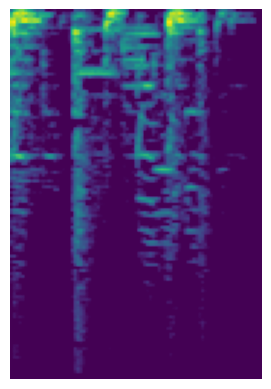

In [58]:
for num, i in enumerate(S_db_mel_list[:4]):
    plt.imshow(i)
    plt.axis('off')
    
    plt.savefig('test_folder/test_file_{}.png'.format(num), bbox_inches='tight',pad_inches = 0)




(128, 87)


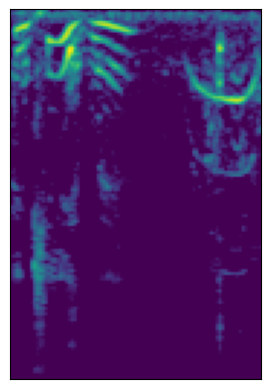

In [61]:
test_mel = S_db_mel_list[1]
print(test_mel.shape)
show(test_mel)

In [49]:
#Now, let us use features from convolutional network for RF
feature_extractor=VGG_model.predict(test_set)

features = feature_extractor.reshape(feature_extractor.shape[0], -1)
X_train = features #This is our X input to RF

features = feature_extractor.reshape(feature_extractor.shape[0], -1)

InvalidArgumentError: Graph execution error:

Detected at node 'vgg16/block1_conv1/Relu' defined at (most recent call last):
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/runpy.py", line 196, in _run_module_as_main
      return _run_code(code, main_globals, None,
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/runpy.py", line 86, in _run_code
      exec(code, run_globals)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/ipykernel_launcher.py", line 17, in <module>
      app.launch_new_instance()
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/traitlets/config/application.py", line 1043, in launch_instance
      app.start()
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/ipykernel/kernelapp.py", line 725, in start
      self.io_loop.start()
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/tornado/platform/asyncio.py", line 195, in start
      self.asyncio_loop.run_forever()
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/asyncio/base_events.py", line 603, in run_forever
      self._run_once()
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/asyncio/base_events.py", line 1909, in _run_once
      handle._run()
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/asyncio/events.py", line 80, in _run
      self._context.run(self._callback, *self._args)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/ipykernel/kernelbase.py", line 513, in dispatch_queue
      await self.process_one()
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/ipykernel/kernelbase.py", line 502, in process_one
      await dispatch(*args)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/ipykernel/kernelbase.py", line 409, in dispatch_shell
      await result
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/ipykernel/kernelbase.py", line 729, in execute_request
      reply_content = await reply_content
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/ipykernel/ipkernel.py", line 422, in do_execute
      res = shell.run_cell(
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/ipykernel/zmqshell.py", line 540, in run_cell
      return super().run_cell(*args, **kwargs)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3009, in run_cell
      result = self._run_cell(
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3064, in _run_cell
      result = runner(coro)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/IPython/core/async_helpers.py", line 129, in _pseudo_sync_runner
      coro.send(None)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3269, in run_cell_async
      has_raised = await self.run_ast_nodes(code_ast.body, cell_name,
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3448, in run_ast_nodes
      if await self.run_code(code, result, async_=asy):
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3508, in run_code
      exec(code_obj, self.user_global_ns, self.user_ns)
    File "/var/folders/8q/qvkg_x054xg6wpd18ns2jgp40000gn/T/ipykernel_37259/712823176.py", line 2, in <module>
      feature_extractor=VGG_model.predict(test_set)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/utils/traceback_utils.py", line 65, in error_handler
      return fn(*args, **kwargs)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/engine/training.py", line 2382, in predict
      tmp_batch_outputs = self.predict_function(iterator)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/engine/training.py", line 2169, in predict_function
      return step_function(self, iterator)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/engine/training.py", line 2155, in step_function
      outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/engine/training.py", line 2143, in run_step
      outputs = model.predict_step(data)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/engine/training.py", line 2111, in predict_step
      return self(x, training=False)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/utils/traceback_utils.py", line 65, in error_handler
      return fn(*args, **kwargs)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/engine/training.py", line 558, in __call__
      return super().__call__(*args, **kwargs)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/utils/traceback_utils.py", line 65, in error_handler
      return fn(*args, **kwargs)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/engine/base_layer.py", line 1145, in __call__
      outputs = call_fn(inputs, *args, **kwargs)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/utils/traceback_utils.py", line 96, in error_handler
      return fn(*args, **kwargs)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/engine/functional.py", line 512, in call
      return self._run_internal_graph(inputs, training=training, mask=mask)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/engine/functional.py", line 669, in _run_internal_graph
      outputs = node.layer(*args, **kwargs)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/utils/traceback_utils.py", line 65, in error_handler
      return fn(*args, **kwargs)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/engine/base_layer.py", line 1145, in __call__
      outputs = call_fn(inputs, *args, **kwargs)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/utils/traceback_utils.py", line 96, in error_handler
      return fn(*args, **kwargs)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/layers/convolutional/base_conv.py", line 321, in call
      return self.activation(outputs)
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/activations.py", line 317, in relu
      return backend.relu(
    File "/Users/kimmonica/miniforge3/envs/tensorflow_mac/lib/python3.10/site-packages/keras/backend.py", line 5396, in relu
      x = tf.nn.relu(x)
Node: 'vgg16/block1_conv1/Relu'
input must be 4-dimensional[32,369,251]
	 [[{{node vgg16/block1_conv1/Relu}}]] [Op:__inference_predict_function_1601]

In [66]:
!python DataFrame_Multiprocess_module.py

starting multiprocessing...
8
[src/libmpg123/parse.c:skip_junk():1276] error: Giving up searching valid MPEG header after 65536 bytes of junk.
[src/libmpg123/parse.c:skip_junk():1276] error: Giving up searching valid MPEG header after 65536 bytes of junk.
[src/libmpg123/parse.c:skip_junk():1276] error: Giving up searching valid MPEG header after 65536 bytes of junk.

How To Block Negative Thoughts  Motivated.mp3 processed
Wake Up Right  Motivated.mp3 processed
NEVER GIVE UP NO MATTER WHAT - Steve Harvey POWERFUL SPEECH - Faith is EVERYTHING!.mp3 processed
done multiprocessing...
time : 494.35442304611206
